# Metadata

```
Course:   DS 5001 
Module:   05 Lab
Topic:    BOW, Vector Spaces, and TFIDF
Author:   R.C. Alvarado
```

# Overview

In this notebook, we explore Luhn's concept of term significance in light of Zipf's Law, TFIDF, and vector space models of text. 

Recall Luhn's (1958) representation of the problem:

<img src="luhn.png"/>

# Set Up

In [1]:
data_home = "../data"
local_lib = "../lib"
data_prefix = 'austen-melville'

In [2]:
gradient_cmap = 'YlGnBu'  # YlGn, GnBu, YlGnBu; For tables; see https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html 

In [3]:
OHCO = ['book_id', 'chap_id', 'para_num', 'sent_num', 'token_num']

In [4]:
SENTS = OHCO[:4]
PARAS = OHCO[:3]
CHAPS = OHCO[:2]
BOOKS = OHCO[:1]

In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly_express as px

In [6]:
sns.set()

# Acquire Data

We grab our **analytical edition** of a selection of works from Austen and Melville.

In [7]:
LIB = pd.read_csv(f"{data_home}/output/{data_prefix}-LIB.csv").set_index(BOOKS)
CORPUS = pd.read_csv(f"{data_home}/output/{data_prefix}-CORPUS.csv").set_index(OHCO)
VOCAB = pd.read_csv(f"{data_home}/output/{data_prefix}-VOCAB.csv").set_index('term_str')
VOCAB = VOCAB.drop('cat_pos', 1) # Drop this column for readability

In [8]:
# LIB.head()

In [9]:
# VOCAB.head()

In [10]:
# CORPUS.head()

## Gather POS information

In [11]:
pos_info = f'{data_home}/misc/upenn_tagset.txt'
POS = pd.DataFrame([(line.split()[0], ' '.join(line.split()[1:])) 
                    for line in open(pos_info, 'r').readlines()])
POS.columns = ['pos_id', 'pos_def']
POS = POS.set_index('pos_id')
POS['pos_group'] = POS.apply(lambda x: x.name[:2], 1)

In [12]:
VOCAB['max_pos_group'] =  VOCAB.max_pos.apply(lambda x: x[:2])
CORPUS['pos_group'] = CORPUS.pos.apply(lambda x: x[:2])

# Zipf's Law

First, we explore Zipf's Law, which may be expressed by $f \propto \frac{1}{r}$ and the constant $k =  fr$.

Essentially, it says the frequency of tokens in a language is logarithmic. It is a property of all known human languages. 

Specifically, it says the tokens can be ranked $r = 1,2,3,4, \dots ,N$ where (1) the rank is inversely proportional to the frequency, i.e. the lower the rank number, the higher the frequency, and (2) the frequency of a rank $r$ word is $1/r$ times that the most frequent word $r = 1$. So, the rank 2 word occurs half as often as the rank 1 word, the rank 3 word one-third as often, the rank 4 word one-fourth as often, and so forth. The law breaks down at around $r = 1000$.

The law turns out to need some tweaking. 

Here we try to reproduce it with our data.

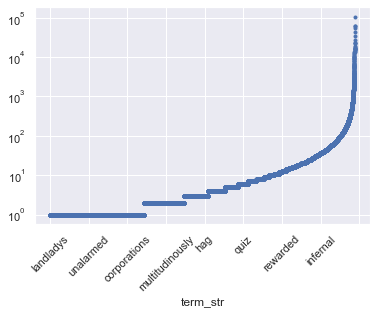

In [13]:
VOCAB.n.sort_values().plot(logy=True, style='.', rot=45);

## Add Term Rank $r$ to `VOCAB`

In [14]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending=False).reset_index()
    VOCAB.index.name = 'term_rank'
    VOCAB = VOCAB.reset_index()
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1
    VOCAB = VOCAB.set_index('term_str')

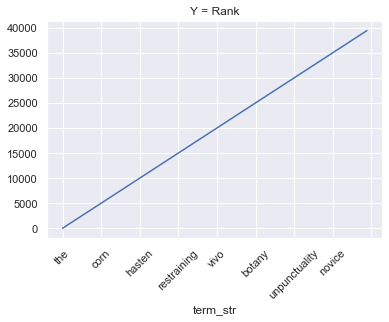

In [15]:
VOCAB.term_rank.plot(logx=False, rot=45, title="Y = Rank");

## Alternate Rank

Note this the above method does not group words with the same frequency, and thus arbitrarily assigns ranks for words with the same frequency. So we try coming up with rank as a grouping feature.

In [16]:
new_rank = VOCAB.n.value_counts()\
    .sort_index(ascending=False).reset_index().reset_index()\
    .rename(columns={'level_0':'term_rank2', 'index':'n', 'n':'nn'})\
    .set_index('n')

In [17]:
new_rank

,term_rank2,nn
n,,
104874,0,1
63153,1,1
61104,2,1
54397,3,1
42556,4,1
...,...,...
5,772,1703
4,773,2257
3,774,3099


In [18]:
VOCAB['term_rank2'] = VOCAB.n.map(new_rank.term_rank2) + 1

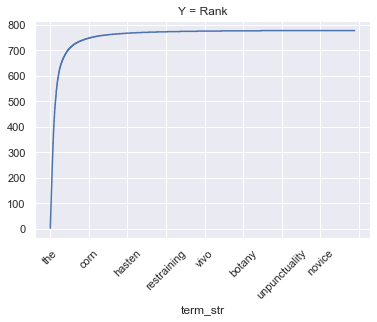

In [19]:
VOCAB.term_rank2.plot(logx=False, rot=45, title="Y = Rank");

## Compute Zipf's $k$

We compute $k$ using both types of rank. Note that this *should* be a constant, but it is not. This is a function of the data size (support) and the fact that Zipf's law is not perfect. 

In [20]:
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank
VOCAB['zipf_k2'] = VOCAB.n * VOCAB.term_rank2

##  Rank and N

In [21]:
px.scatter(VOCAB.reset_index(), 
           x='n', y='term_rank2', 
           log_y=False, log_x=False,
           hover_name='term_str',
           color='max_pos_group',
           height=500, width=800)

## Demo Rank Index

In [22]:
rank_index = [1, 2, 3, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 125, 150, 175, 200, 225, 250, 275, 300, 325, 350, 375, 400, 450, 500, 550, 600, 700, 800]
demo = VOCAB.loc[VOCAB.term_rank2.isin(rank_index), 
                 ['term_rank2', 'n', 'zipf_k2', 'max_pos']].head(50)

In [23]:
demo.style.background_gradient(cmap='YlGnBu', high=.5)

,term_rank2,n,zipf_k2,max_pos
term_str,,,,
the,1,104874,104874,DT
of,2,63153,126306,IN
and,3,61104,183312,CC
it,10,22637,226370,PRP
you,20,13999,279980,PRP
so,30,9457,283710,RB
their,40,6833,273320,PRP$
now,50,5473,273650,RB
upon,60,4241,254460,IN


# BOW

In [24]:
bag = CHAPS

In [25]:
BOW = CORPUS.groupby(bag+['term_str']).term_str.count().to_frame('n') 

In [26]:
# BOW['c'] = BOW.n.astype('bool').astype('int')

In [27]:
BOW.head()

n
book_id chap_id term_str   
105     1       1         2
                15        1
                16        1
                1760      1
                1784      1

In [28]:
BOW.sample(10)

n
book_id chap_id term_str    
8118    75      altered    1
161     47      which     12
10712   24      no         5
121     23      down       1
15422   18      other      2
13720   83      arrived    1
121     18      proof      1
13720   100     amazed     1
        82      lately     1
34970   66      smoke      1

In [29]:
BOW.loc[(105,2)].sort_values('n', ascending=False).head(10)

,n
term_str,
of,94
the,77
and,66
to,65
a,46
in,44
her,37
she,32
was,30


## Document-Term Matrix

We create a document-term count matrix. Note that we can create a matrix for any of the features in BOW. Also, see how the OHCO helps us distinguish between features and observation identity.

Note, these operations are slower than using `groupby()`.

## Create Count Matrix

In [30]:
DTCM = BOW.n.unstack() #.fillna(0).astype('int')

In [31]:
DTCM.head(10)

term_str          0    1  10  100  1000  10000  10440  10800  10th  118952  \
book_id chap_id                                                              
105     1       NaN  2.0 NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        2       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        3       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        4       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        5       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        6       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        7       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        8       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        9       NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   
        10      NaN  NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN     NaN   

term_str         ...  zoroaster  zozo  zuma  zur   à  æneas  æniad  æson  \
book_id chap_id  ...                                                       
105     1        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        2        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        3        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        4        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        5        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        6        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        7        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        8        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        9        ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   
        10       ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   NaN   

term_str         æsops  ł20000  
book_id chap_id                 
105     1          NaN     NaN  
        2          NaN     NaN  
        3          NaN     NaN  
        4          NaN     NaN  
        5          NaN     NaN  
        6          NaN     NaN  
        7          NaN     NaN  
        8          NaN     NaN  
        9          NaN     NaN  
        10         NaN     NaN  

[10 rows x 39424 columns]

# TFIDF

## Compute TF

In [32]:
tf_method = 'sum' # sum, max, log, double_norm, raw, binary

In [33]:
print('TF method:', tf_method)
if tf_method == 'sum':
    TF = DTCM.T / DTCM.T.sum()
elif tf_method == 'max':
    TF = DTCM.T / DTCM.T.max()
elif tf_method == 'log':
    TF = np.log10(DTCM.T + 1)
elif tf_method == 'raw':
    TF = DTCM.T
elif tf_method == 'bool':
    TF = DTCM.T.astype('bool') #.astype('int')
TF = TF.T

TF method: sum


In [34]:
TF.head()

term_str          0         1  10  100  1000  10000  10440  10800  10th  \
book_id chap_id                                                           
105     1       NaN  0.000762 NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        2       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        3       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        4       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        5       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   

term_str         118952  ...  zoroaster  zozo  zuma  zur   à  æneas  æniad  \
book_id chap_id          ...                                                 
105     1           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        2           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        3           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        4           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        5           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   

term_str         æson  æsops  ł20000  
book_id chap_id                       
105     1         NaN    NaN     NaN  
        2         NaN    NaN     NaN  
        3         NaN    NaN     NaN  
        4         NaN    NaN     NaN  
        5         NaN    NaN     NaN  

[5 rows x 39424 columns]

## Compute DF

In [35]:
# DF = DTCM[DTCM > 0].count()
DF = DTCM.count() # THIS WORKS IF WE KEPT NULLS IN DTCM

In [36]:
DF.sort_values(ascending=False)

term_str
the          1156
of           1150
a            1142
in           1135
to           1132
             ... 
lashless        1
lascelles       1
las             1
larynx          1
ł20000          1
Length: 39424, dtype: int64

## Compute IDF

In [37]:
idf_method = 'standard' # standard, max, smooth

In [38]:
N = DTCM.shape[0]

In [39]:
# DP = DF/N

In [40]:
# DP

In [41]:
print('IDF method:', idf_method)
if idf_method == 'standard':
    IDF = np.log10(N / DF)
elif idf_method == 'max':
    IDF = np.log10(DF.max() / DF) 
elif idf_method == 'smooth':
    IDF = np.log10((1 + N) / (1 + DF)) + 1

IDF method: standard


In [42]:
IDF

term_str
0         3.073352
1         2.031959
10        2.374382
100       2.772322
1000      2.772322
            ...   
æneas     3.073352
æniad     3.073352
æson      3.073352
æsops     3.073352
ł20000    3.073352
Length: 39424, dtype: float64

## Compute TFIDF

In [43]:
TFIDF = TF * IDF

In [44]:
TFIDF.head()

term_str          0         1  10  100  1000  10000  10440  10800  10th  \
book_id chap_id                                                           
105     1       NaN  0.001548 NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        2       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        3       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        4       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   
        5       NaN       NaN NaN  NaN   NaN    NaN    NaN    NaN   NaN   

term_str         118952  ...  zoroaster  zozo  zuma  zur   à  æneas  æniad  \
book_id chap_id          ...                                                 
105     1           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        2           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        3           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        4           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   
        5           NaN  ...        NaN   NaN   NaN  NaN NaN    NaN    NaN   

term_str         æson  æsops  ł20000  
book_id chap_id                       
105     1         NaN    NaN     NaN  
        2         NaN    NaN     NaN  
        3         NaN    NaN     NaN  
        4         NaN    NaN     NaN  
        5         NaN    NaN     NaN  

[5 rows x 39424 columns]

## Move things to their places

In [45]:
VOCAB['df'] = DF
VOCAB['idf'] = IDF

In [46]:
# VOCAB.head()

In [47]:
BOW['tf'] = TF.stack()
BOW['tfidf'] = TFIDF.stack()

In [48]:
BOW.head()

n        tf     tfidf
book_id chap_id term_str                       
105     1       1         2  0.000762  0.001548
                15        1  0.000381  0.001056
                16        1  0.000381  0.001171
                1760      1  0.000381  0.001171
                1784      1  0.000381  0.001171

# Aggregate TFIDF

## Add aggregates to VOCAB

In [49]:
VOCAB['tfidf_mean'] = TFIDF[TFIDF > 0].mean().fillna(0) # EXPLAIN
VOCAB['tfidf_max'] = TFIDF.max()

## DFIDF

In [50]:
VOCAB['dfidf'] = VOCAB.df * VOCAB.idf

In [51]:
VOCAB['dfidf2'] = VOCAB.df/N * VOCAB.idf

In [52]:
px.scatter(VOCAB.reset_index(), x='term_rank2', y='dfidf', color='max_pos', hover_name='term_str', height=500)

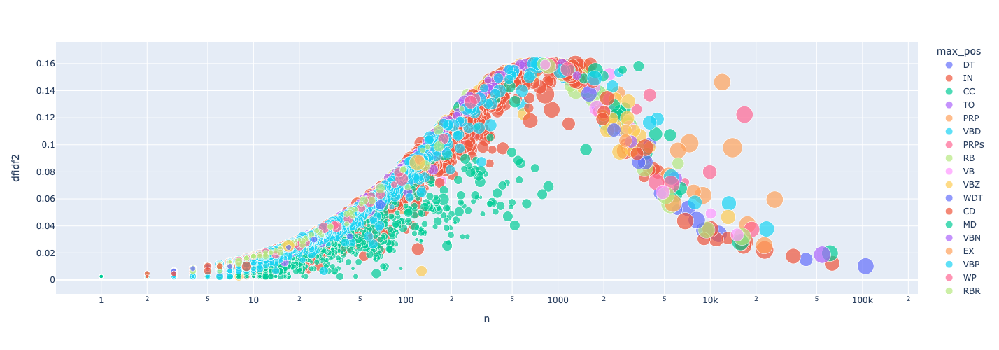

In [78]:
px.scatter(VOCAB.reset_index(), x='n', y='dfidf2', color='max_pos', size="n_pos", hover_name='term_str', log_x=True, width=800, height=500)

## Observe results

In [55]:
my_cols = "n term_rank2 zipf_k2 max_pos tfidf_mean tfidf_max dfidf".split()

In [56]:
VOCAB[my_cols].sort_values('term_rank2', ascending=True).head(100).style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
the,104874,1,104874,DT,0.000609,0.005197,12.015312
of,63153,2,126306,IN,0.000436,0.004218,14.551941
and,61104,3,183312,CC,0.000649,0.005164,23.322612
to,54397,4,217588,TO,0.000517,0.001951,22.079972
a,42556,5,212780,DT,0.000372,0.005229,17.912953
in,35120,6,210720,IN,0.000359,0.006119,20.833879
i,26489,7,185423,PRP,0.000981,0.004974,70.450300
was,23414,8,187312,VBD,0.000467,0.001558,44.696428
that,22767,9,204903,IN,0.000273,0.003337,26.208625


In [57]:
VOCAB[my_cols].sort_values('tfidf_mean', ascending=False).head(50)\
    .style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
hypothetical,3,775,2325,NNP,0.289746,0.865410,7.788691
slushing,2,776,1552,NNP,0.231715,0.462054,5.544643
charmers,9,769,6921,NNS,0.175808,0.519246,7.788691
disputations,2,776,1552,NN,0.173488,0.346540,5.544643
tusculan,2,776,1552,NNP,0.173488,0.346540,5.544643
um,12,766,9192,JJ,0.168662,0.497151,7.788691
inquest,2,776,1552,NNP,0.155159,0.308036,5.544643
unbends,2,776,1552,NN,0.140837,0.277232,5.544643
increases,4,774,3096,VBZ,0.124327,0.494258,9.885167


In [58]:
VOCAB[my_cols].sort_values('dfidf', ascending=False).head(50)\
    .style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
home,936,219,204984,NN,0.000470,0.004093,189.165233
cried,1218,168,204624,VBD,0.000738,0.005850,189.164306
certain,671,277,185867,JJ,0.000485,0.031276,189.158957
why,871,227,197717,WRB,0.000531,0.016880,189.154880
whether,729,257,187353,IN,0.000524,0.021944,189.154880
looking,851,234,199134,VBG,0.000445,0.003399,189.136595
set,691,271,187261,VBN,0.000369,0.001919,189.130117
general,804,245,196980,JJ,0.000426,0.002425,189.119336
manner,727,258,187566,NN,0.000382,0.002216,189.119336


In [59]:
BOW.sort_values('tfidf', ascending=False).head(20).style.background_gradient(cmap=gradient_cmap, high=.5)

## More Visualizations

#### Rank and TFIDF Mean

In [60]:
px.scatter(VOCAB.reset_index(), 
           x='term_rank2', y='tfidf_mean', 
           color='max_pos', size='n_pos',
           hover_name='term_str', hover_data=['n','i'],
           log_y=True, log_x=False,
#            height=500, width=800
          )

In [61]:
px.scatter(VOCAB.reset_index(), 
           x='term_rank2', y='dfidf', 
           color='max_pos', size='n_pos',
           hover_name='term_str', hover_data=['n','i'],
#            height=500, width=800
          )

#### Show Demo Table with TFIDF

In [62]:
demo2 = VOCAB.loc[VOCAB.term_rank2.isin(rank_index), my_cols]

In [63]:
demo2.style.background_gradient(cmap='YlGnBu')

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
the,104874,1,104874,DT,0.000609,0.005197,12.015312
of,63153,2,126306,IN,0.000436,0.004218,14.551941
and,61104,3,183312,CC,0.000649,0.005164,23.322612
it,22637,10,226370,PRP,0.000300,0.002477,30.298570
you,13999,20,279980,PRP,0.001072,0.008360,115.832310
so,9457,30,283710,RB,0.000208,0.008147,43.910111
their,6833,40,273320,PRP$,0.000370,0.002467,85.715535
now,5473,50,273650,RB,0.000206,0.001029,66.415891
upon,4241,60,254460,IN,0.000318,0.016062,97.198282


## Reduce VOCAB

In [64]:
key_col = 'dfidf'
key_quantile = .9
key_min = VOCAB[key_col].quantile(key_quantile)

In [65]:
SIGS = VOCAB.loc[VOCAB[key_col] >= key_min].sort_values(key_col, ascending=False)

In [66]:
SIGS.shape[0]

4004

In [67]:
SIGS[my_cols].sample(100).style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
thy,599,307,183893,JJ,0.002480,0.011559,145.304889
reached,171,607,103797,VBD,0.000542,0.003186,127.307421
hearing,243,536,130248,VBG,0.000490,0.002030,152.044318
hull,87,691,60117,NN,0.001128,0.005101,85.180680
hereafter,92,686,63112,NN,0.000822,0.005738,94.354201
touching,171,607,103797,VBG,0.001587,0.116292,129.316829
ridiculous,50,728,36400,JJ,0.000818,0.002635,67.774625
take,1191,176,209616,VB,0.000343,0.005100,179.379275
world,1291,164,211724,NN,0.000387,0.003224,177.534291


# Save Work

In [68]:
# VOCAB.to_csv(f'{data_home}/output/{data_prefix}-VOCAB2.csv') # USED IN HW
# CORPUS.to_csv(f'{data_home}/output/{data_prefix}-CORPUS2.csv')
# BOW.to_csv(f'{data_home}/output/{data_prefix}-BOW.csv')
# DTCM.to_csv(f'{data_home}/output/{data_prefix}-DTCM.csv')

In [69]:
# TFIDF.to_csv(f'{data_home}/output/{data_prefix}-TFIDF.csv')
# SIGS.to_csv(f'{data_home}/output/{data_prefix}-SIGS.csv')
# WCM.to_csv(f'{data_home}/output/{data_prefix}-WCM.csv')

In [79]:
# TFIDF[SIGS.index].to_csv(f'{data_home}/output/{data_prefix}-TFIDF_REDUCED.csv')